In [1]:
import librosa
import numpy as np
from scipy.io import wavfile
import IPython

#name = './stedman9.wav'
#cambridge, sr = librosa.load(name)

# This is a touch of Stedman triples on our back 8.
five_name = '/Users/gfr/Google Drive/ny striking/single bells/five.wav'
five_sr, five = wavfile.read(five_name)
print(five.shape, five_sr)
five_left = five[:,0]/(32*1024.0)
five_right = five[:,1]/(32*1024.0)
print np.max(five_left)

#alt, alt_sr = librosa.load(name)
#IPython.display.Audio(data=alt, rate=alt_sr)


((844544, 2), 48000)
0.329376220703


/opt/intel/intelpython27/lib/python2.7/site-packages/scipy/io/wavfile.py:267: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


In [2]:
''' Load audio, compute spectrogram and nmf.'''
import matplotlib.pyplot as plt
from scipy import signal
import numpy as np
import librosa
import IPython
import math
from scipy import stats
from scipy import linalg
from sklearn.decomposition import NMF
from scipy.cluster.vq import whiten

def spec(clip, sr, width, white=False):
  print(len(clip), max(clip))
  f, t, Sxx = signal.spectrogram(clip, sr, mode='magnitude',
                                 nperseg=width, nfft=width,
                                 noverlap=width-width//8, scaling='density')
  print('frequency resolution is: ', f[1]-f[0])
  # scale by frequency, to get power per octave, or more radical scaling??
  # When scaled by f**3, we get a dramatic percussive signal.  This requires adding another NMF
  # component, that will emphasize the percussive element.  It's inconsistent, though, so probably
  # not worth the trouble.
  # Scaling by f**2, we get very nice definition of the bell spectra.
  if sr == 48000: 
    Sxx = Sxx[:(3*len(f))//4,]
    f = f[:3*len(f)//4]
  if white:
    Sxx = whiten(Sxx.T).T
  else:
    Sxx = np.multiply(Sxx.T, np.arange(len(f))**2).T
    #Sxx = np.sqrt(Sxx)  # Terrible hack
  fig = plt.figure(figsize=(50,5), dpi=120)
  
  print np.percentile(Sxx, 99.9), np.max(Sxx)
  plt.imshow(Sxx, origin='lower', aspect='auto', extent=[0,t[-1],0,f[-1]], cmap='plasma', clim=(0,np.percentile(Sxx,99.9)))
  plt.show()

  '''
  plt.figure(figsize=(8,8), dpi=120)
  plt.imshow(np.corrcoef(Sxx), origin='lower', cmap='plasma') 
  plt.colorbar()
  plt.show()
  '''
  return f, t, Sxx



(844544, 0.33502197265625)
('frequency resolution is: ', 93.75)
12121.6529975 41251.4847476


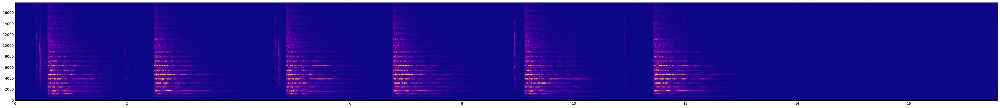

(844544, 0.329376220703125)
('frequency resolution is: ', 93.75)
8958.13423414 26437.3790361


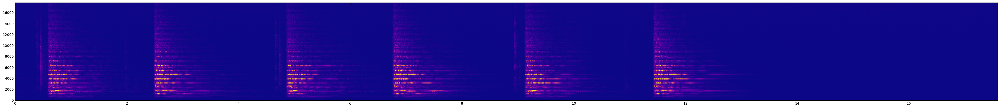

In [3]:
five_f, five_t, five_Sxx_r = spec(five_right, five_sr, 512, False)
five_f, five_t, five_Sxx_l = spec(five_left, five_sr, 512, False)
five_fps = 1/(five_t[1]-five_t[0])


/opt/intel/intelpython27/lib/python2.7/site-packages/ipykernel/__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


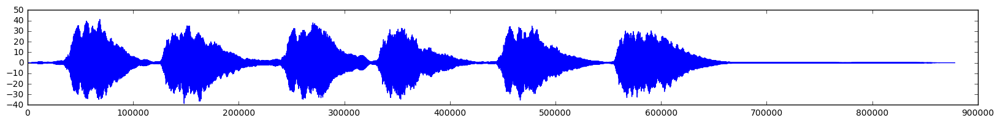

In [4]:
from scipy.signal import fftconvolve

c = fftconvolve(five_right, five_right[11.3*five_sr:12*five_sr], mode='full')
plt.figure(figsize=(20,2), dpi=120)
plt.plot(c) 
plt.show()


8958.13423414 26437.3790361


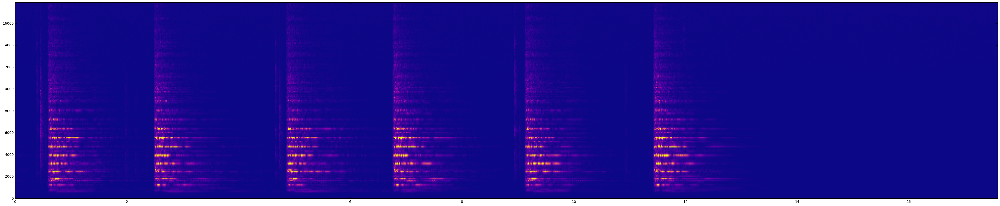

(192, 13189) 750.0


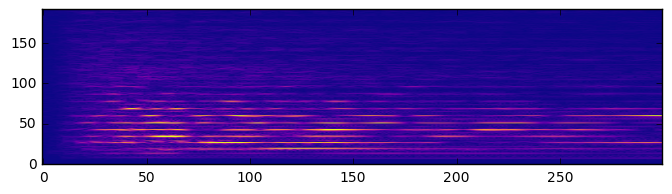

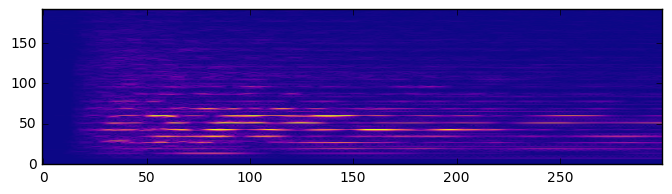

left templates against left channel
fast shapes:  (300, 192) (192, 13189)
done


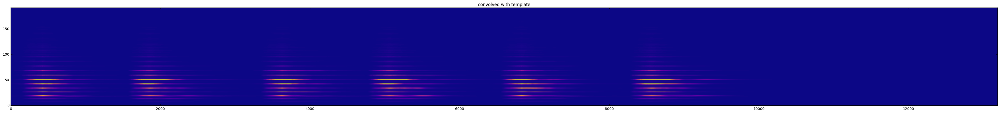

(13189,)
fast shapes:  (300, 192) (192, 13189)
done


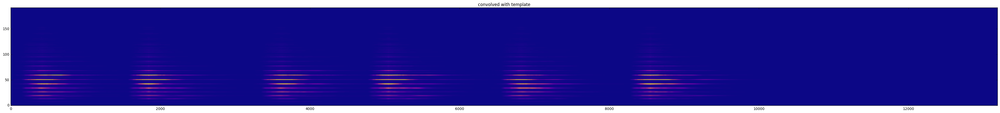

(13189,)


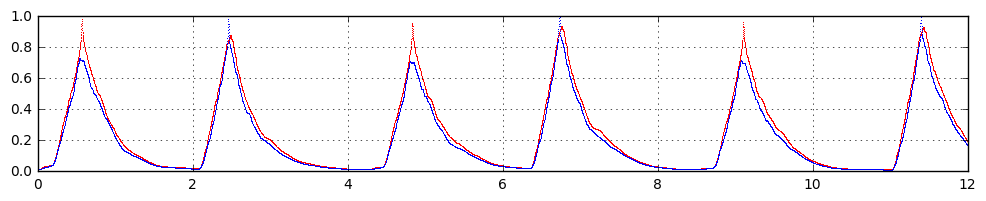

left templates against right channel
fast shapes:  (300, 192) (192, 13189)
done


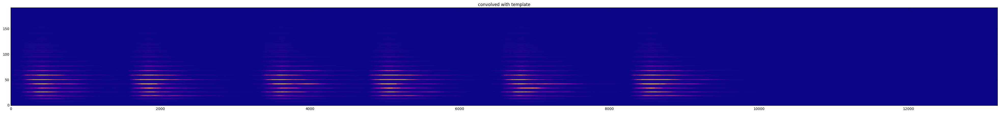

(13189,)
fast shapes:  (300, 192) (192, 13189)
done


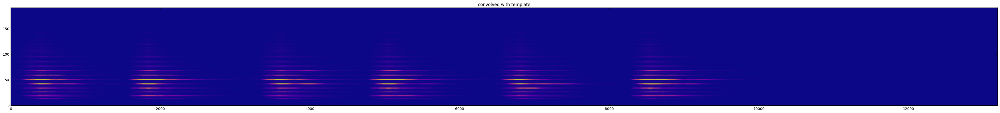

(13189,)


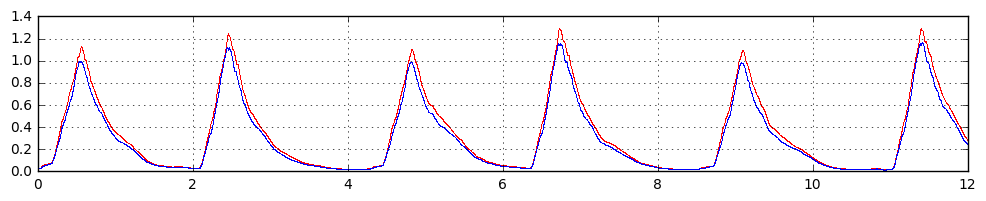

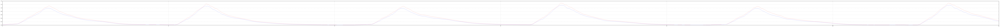

In [56]:
'''
This cell demonstrates that the spectrogram from a single bell very nicely picks out the strikes
on the same stroke, and picks out the alternate strokes, but with less precision and lower amplitude.

However, it ALSO demonstrates that the microphone placement (and probably other acoustic details)
matter a great deal in both the ability to discriminate between strokes, AND the precision of
the same stroke detection.

So, for recordings taken with identical microphone placement, using the spectrogram of an individual
bell as a correlation template may work well, but if microphone placement changes, the precision
degrades very quickly.

This makes a lot of sense when you realize that one millisecond of delay corresponds to about one
foot change in microphone placement, AND that there is likely quite a large contribution from
multipath - i.e., echos of the bell sound off the walls of the belfry and intermediate chamber.
The multipath is the same mechanism that results in very muddy sound in towers like Liverpool, where
the multipath delays are very large and the echos are very strong.
'''

from scipy.signal import fftconvolve

def match(template, other):
    norm = np.sum(np.multiply(template, template))
    r = np.sum(np.multiply(template, other))
    return r/norm

def plot_template(template):
  fig = plt.figure(figsize=(8,2), dpi=120)
  plt.imshow(template.T, origin='lower', aspect='auto', cmap='plasma', clim=(0,np.percentile(template,99.9)))
  plt.show()

def make_template(offset, Sxx, fps, length=.4):
  template = np.array(Sxx.T[int(offset*fps):int((offset+length)*fps)])
#  norm = np.sum(np.multiply(template, template))
#  template *= 1/np.sqrt(norm)

  plot_template(template)
  return template

def fast_match_sliding(template, Sxx):
  ''' Use fft convolution on each frequency, then add them up.
  '''
  norm = np.sum(np.multiply(template, template))
  result = np.empty_like(Sxx)
  print 'fast shapes: ', template.shape, Sxx.shape
  for i in range(template.shape[1]):
    result[i] = fftconvolve(Sxx[i], template.T[i][::-1])[template.shape[0]-1:]
  result /= norm
  print 'done'

  fig = plt.figure(figsize=(50,5), dpi=120)
  plt.title('convolved with template')
  plt.imshow(result, origin='lower', aspect='auto', cmap='plasma', clim=(0,np.percentile(result,99.9)))
  plt.show()
    
  print result.sum(axis=0).shape
  return result.sum(axis=0)

print np.percentile(five_Sxx_l, 99.9), np.max(five_Sxx_l)
fig = plt.figure(figsize=(50,10), dpi=120)  
plt.imshow(five_Sxx_l, origin='lower', aspect='auto',
           extent=[0,five_t[-1],0,five_f[-1]], cmap='plasma', clim=(0,np.percentile(five_Sxx_l,99.9)))
plt.show()

print five_Sxx_l.shape, five_fps
#template = np.array(Sxx.T[int(.57*fps):int(1.5*fps)])
hand_template = make_template(.57, five_Sxx_l, five_fps)
back_template = make_template(2.46, five_Sxx_l, five_fps)

print 'left templates against left channel'
hand = fast_match_sliding(hand_template, five_Sxx_l)
back = fast_match_sliding(back_template, five_Sxx_l)
plt.figure(figsize=(12,2), dpi=120)
axes = plt.gca()
axes.set_xlim([0, 12])
axes.set_ylim([0,1])
plt.grid()
plt.plot(range(len(hand))/five_fps, hand, 'r,')
plt.plot(range(len(back))/five_fps, back, 'b,')
plt.show()

print 'left templates against right channel'
hand = fast_match_sliding(hand_template, five_Sxx_r)
back = fast_match_sliding(back_template, five_Sxx_r)
plt.figure(figsize=(12,2), dpi=120)
axes = plt.gca()
axes.set_xlim([0, 12])
#axes.set_ylim([0,1.2])
plt.grid()
plt.plot(range(len(hand))/five_fps, hand, 'r,')
plt.plot(range(len(back))/five_fps, back, 'b,')
plt.show()

plt.figure(figsize=(200,5), dpi=120)
axes = plt.gca()
axes.set_xlim([0, 12])
#axes.set_ylim([0,1])
plt.grid()
plt.plot(range(len(hand))/five_fps, hand, 'r,')
plt.plot(range(len(back))/five_fps, back, 'b,')
plt.show()


((21529280, 2), 48000)
(844544, 0.329376220703125)
('frequency resolution is: ', 93.75)
8958.13423414 26437.3790361


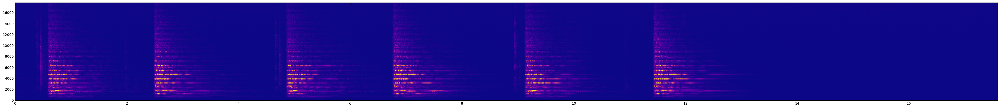

(844544, 0.33502197265625)
('frequency resolution is: ', 93.75)
12121.6529975 41251.4847476


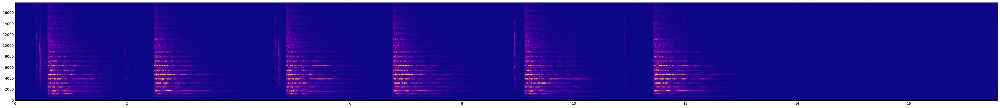

In [6]:
import librosa
from scipy.io import wavfile
import IPython

#name = './stedman9.wav'
#cambridge, sr = librosa.load(name)

# This is a touch of Stedman triples on our back 8.
name = '/Users/gfr/Google Drive/ny striking/Early January/STE-025.wav'
#name = '/Users/gfr/Google Drive/Strikeometer_NewHope/audio/GSM/gsm-ringing-10/2013_02_25_Practice-part6.wav'
stedman_sr, stedman = wavfile.read(name)
print(stedman.shape, stedman_sr)
stedman_left = stedman[:,0]/(32*1024.0)
stedman_right = stedman[:,1]/(32*1024.0)

five_fl, five_tl, five_Sxxl = spec(five_left, five_sr, 512, False)
five_fr, five_tr, five_Sxxr = spec(five_right, five_sr, 512, False)
five_fps = 1/(five_tl[1]-five_tl[0])



(21529280, 0.817626953125)
('frequency resolution is: ', 93.75)
15214.679122 41617.4798502


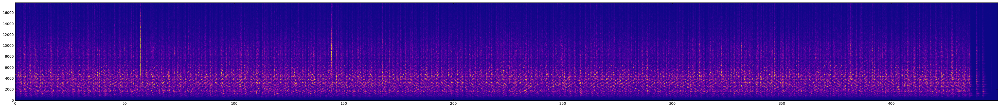

(21529280, 0.76153564453125)
('frequency resolution is: ', 93.75)
15686.5814843 99123.3454991


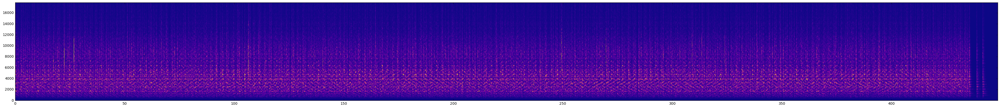

In [7]:
sted_fl, sted_tl, sted_Sxxl = spec(stedman_left, stedman_sr, 512, False)
sted_fr, sted_tr, sted_Sxxr = spec(stedman_right, stedman_sr, 512, False)
sted_fps = 1/(sted_tl[1]-sted_tl[0])


In [8]:
from sortedcontainers import SortedList

def argrelmax(x, order, minval):
    '''argrelmax is similar to signal.argrelmax, but much much faster
    Args: x - the 1D array to search for local max values
          order - the half width of the local region
          minval - the minimum value that may be considered a peak
    returns: list of indices of peaks
    '''
    sort = np.argsort(x)[::-1]  # These are indices into x, largest to smallest x value
    xx = SortedList([-order,len(x)+order+1])
    peaks = SortedList([-order,len(x)+order+1])  # We'll strip the ends when finished
    for t in sort:
        if x[t] < minval: break
        test = xx.bisect(t)
        xx.insert(test, t)
        if xx[test-1]+order < xx[test] and xx[test] < xx[test+1]-order:
            i = peaks.bisect(t)
            peaks.insert(i,t)
    return peaks[1:-1]        


In [62]:
''' Methods for evaluating the selection of peaks. '''

def plot_peaks(t, signal, selected, fps): 
  plt.figure(figsize=(50,2), dpi=120)
  plt.grid()
#  plt.title('stedman left channel with masked template')
  plt.plot(range(len(signal))/fps, signal, 'r,')
  plt.plot(np.array(t)[selected]-.005, np.array(signal)[selected]+.005,
           'b.', fillstyle='none', markersize=5)
  plt.show()


def selection_histo(good, bad, label='peak strengths'):
  plt.figure(figsize=(6,3), dpi=120)
  plt.hist(good, bins='auto')
  plt.hist(bad, bins='auto')
  plt.title(label)
  plt.show()

    
def find_peaks(sig, fps, threshold, use_mag=False, label='peak strengths'):
  print np.percentile(sig, 90), np.max(sig)
  peaks = argrelmax(sig, fps/4, np.percentile(sig, 90))
  selected = []
  strengths = []
  rejects = []
  for i in peaks:
    left = sig[max(0,i-4)]
    right = sig[min(len(sig)-1, i+4)]
    strength = 2*sig[i]/(left+right)
    if (use_mag): strength *= sig[i]
    if strength > threshold: 
        selected.append(i)
        strengths.append(strength)
    else:
        rejects.append(strength)
  print len(strengths), len(rejects)
  selection_histo(strengths, rejects, label)

  return selected

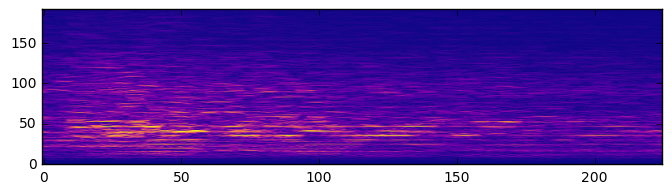

left stedman template against stedman left channel
fast shapes:  (225, 192) (192, 336388)
done


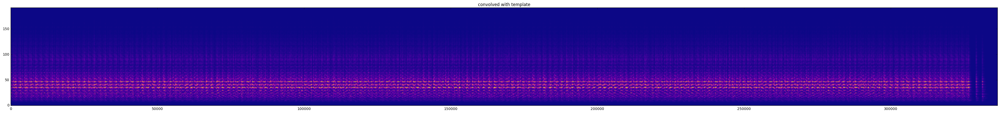

(336388,)
0.619866288399 1.0
72 186


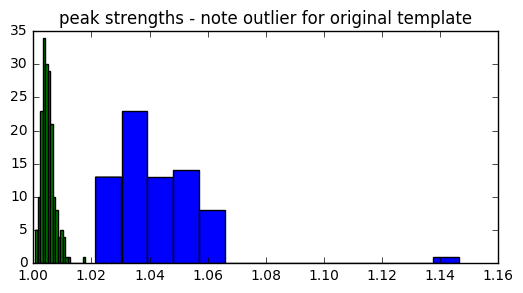

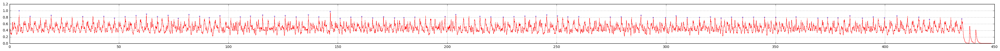

In [63]:
# Now extract sample at 0.2 seconds in the stedman recording.
#stedman_h_template = make_template(.225, sted_Sxxl, fps)
stedman_h_template_l = make_template(4.31, sted_Sxxl, sted_fps, .3)
#stedman_b_template = make_template(2.46, Sxxl, fps)

print 'left stedman template against stedman left channel'
sted_left_hand = fast_match_sliding(stedman_h_template_l, sted_Sxxl)
'''
plt.figure(figsize=(50,2), dpi=120)
axes = plt.gca()
plt.grid()
plt.plot(range(len(hand))/sted_fps, hand, 'r,')
plt.show()

hand = match_sliding(stedman_h_template, sted_Sxxl)
print np.percentile(hand, 95), np.max(hand)
peaks = argrelmax(hand, sted_fps/4, np.percentile(hand, 95))
'''
_ = plot_peaks(sted_tl, sted_left_hand, 
               find_peaks(sted_left_hand, sted_fps, 1.02, False,
                          'peak strengths - note outlier for original template'),
               sted_fps)


[3232, 6957, 14197, 25009, 32246, 35919, 39579, 43307, 46855, 50613, 54322, 57743, 61406, 65122, 68399, 72071, 79004, 82487, 86659, 90752, 94407, 98195, 102353, 105945, 109875, 113253, 116949, 120649, 124363, 128106, 131860, 135145, 138835, 149199, 152909, 161188, 164936, 169127, 172830, 176596, 180309, 184024, 187743, 191258, 194997, 205814, 209622, 216343, 220579, 224770, 228435, 232188, 236374, 240167, 243829, 247412, 251196, 254982, 258726, 262524, 269532, 277025, 280300, 283870, 287987, 292265, 296015, 299829, 304112, 311536, 315239, 326296]
(192, 149)


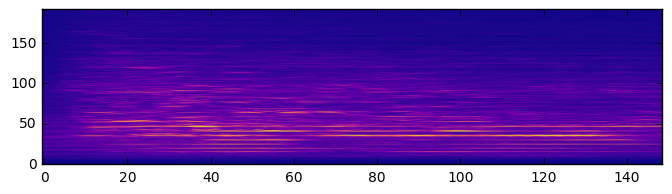

fast shapes:  (149, 192) (192, 336388)
done


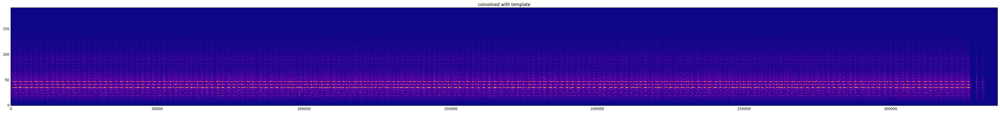

(336388,)


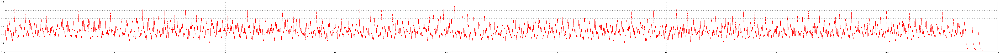

0.686103100292 1.14295216892


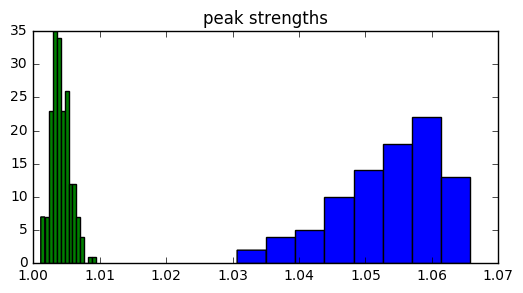

[3232, 6957, 10539, 14197, 17738, 21390, 25009, 28549, 32246, 35920, 39579, 43307, 46855, 50613, 54322, 57743, 61406, 65122, 68399, 72071, 75776, 79004, 82487, 86659, 90752, 94407, 98195, 102353, 105945, 109875, 113253, 116949, 120649, 124363, 128106, 131860, 135145, 138835, 142513, 145773, 149199, 152909, 157402, 161188, 164936, 169127, 172830, 176596, 180309, 184024, 187743, 191258, 194998, 198738, 202082, 205814, 209622, 213117, 216343, 220579, 224770, 228435, 232188, 236374, 240167, 243829, 247412, 251196, 254983, 258726, 262524, 266218, 269532, 273311, 277025, 280300, 283871, 287987, 292265, 296015, 299829, 304112, 307718, 311536, 315239, 318896, 322558, 326296]


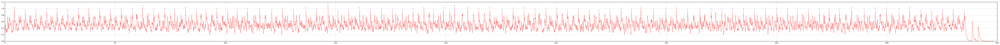

In [58]:
# This one works beautifully.  Need to understand why!!

peaks = argrelmax(sted_left_hand, sted_fps/4, np.percentile(sted_left_hand, 95))
peak_intensity = []
for i in peaks:
    left = sted_left_hand[max(0,i-4)]
    right = sted_left_hand[min(len(sted_left_hand)-1, i+4)]
    size = 2*sted_left_hand[i] / (left+right)
    if size > 1.02: peak_intensity.append(i)

print peak_intensity

# Now, pile up the clips from the interesting offsets
size = int(.2*sted_fps)
final = np.zeros((192,size))
for i in peak_intensity:
    final += sted_Sxxl[:,i:i+size]
final /= len(peak_intensity)
print final.shape

template = make_template(0, final, sted_fps, .2)

sted_left_hand_avg = fast_match_sliding(template, sted_Sxxl)
plt.figure(figsize=(100,5), dpi=120)
axes = plt.gca()
plt.grid()
plt.plot(range(len(sted_left_hand_avg))/sted_fps, sted_left_hand_avg, 'r,')
plt.show()

print np.percentile(sted_left_hand_avg, 90), np.max(sted_left_hand_avg)
peaks = argrelmax(sted_left_hand_avg, sted_fps/4, np.percentile(sted_left_hand_avg, 90))
selected_peaks = []
good = []
bad = []
for i in peaks:
    left = sted_left_hand_avg[max(0,i-4)]
    right = sted_left_hand_avg[min(len(sted_left_hand_avg)-1, i+4)]
    size = 2*sted_left_hand_avg[i]/ (left+right)
    if size > 1.02:
        selected_peaks.append(i)
        good.append(size)
    else:
        bad.append(size)
selection_histo(good, bad)
print selected_peaks

plt.figure(figsize=(100,4), dpi=120)
plt.grid()
plt.plot(range(len(h))/sted_fps, sted_left_hand_avg, 'r,')
plt.plot(np.array(sted_tl)[selected_peaks]-.005, np.array(sted_left_hand_avg)[selected_peaks]+.005,
         'b.', fillstyle='none', markersize=5)
plt.show()



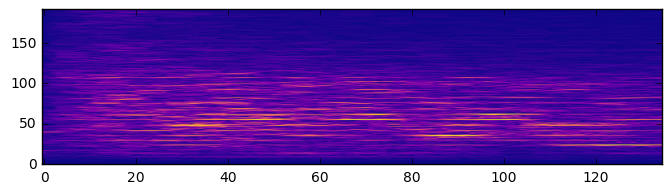

right stedman template against stedman right channel
fast shapes:  (135, 192) (192, 336388)
done


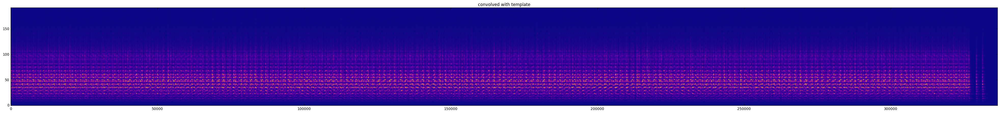

(336388,)


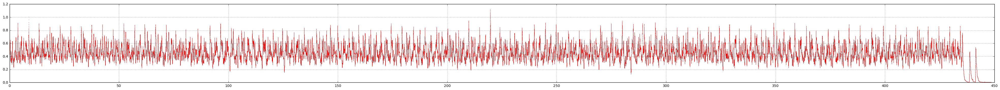

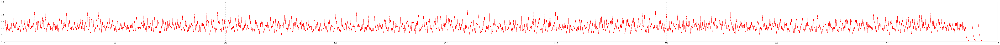

0.619233270273 1.11465693682
45 341


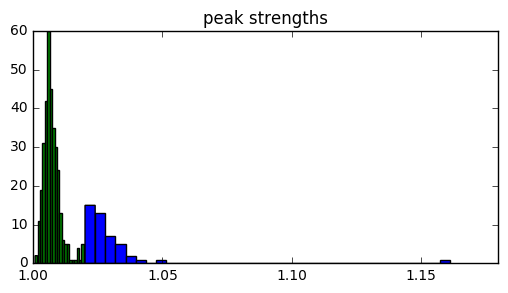

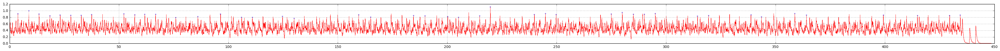

In [64]:
#stedman_h_template = make_template(.225, sted_Sxxl, fps)
sted_right_hand_template = make_template(8.71, sted_Sxxr, sted_fps, .18)
#stedman_b_template = make_template(2.46, Sxxl, fps)

print 'right stedman template against stedman right channel'
sted_right_hand = fast_match_sliding(sted_right_hand_template, sted_Sxxr)
plt.figure(figsize=(50,4), dpi=120)
axes = plt.gca()
plt.grid()
plt.plot(range(len(sted_right_hand))/sted_fps, sted_right_hand, 'r,')
plt.show()

plt.figure(figsize=(100,4), dpi=120)
axes = plt.gca()
plt.grid()
plt.plot(range(len(sted_right_hand))/sted_fps, sted_right_hand, 'r,')
plt.show()

few_peaks = find_peaks(sted_right_hand, sted_fps, 1.02)
plot_peaks(sted_tl, sted_right_hand, few_peaks, sted_fps)



[(2813, 3719), (6532, 3530), (10062, 3702), (13764, 3550), (17314, 3641), (20955, 3586), (24541, 3570), (28111, 11038), (39149, 3697), (42846, 3447), (46293, 3690), (49983, 6935), (56918, 7578), (64496, 7778), (72274, 7217), (79491, 3677), (83168, 10345), (93513, 3946), (97459, 22139), (119598, 4117), (123715, 14674), (138389, 3941), (142330, 7808), (150138, 3710), (153848, 7204), (161052, 3699), (164751, 15082), (179833, 3772), (183605, 3663), (187268, 18918), (206186, 3762), (209948, 3779), (213727, 3769), (217496, 3772), (221268, 14476), (235744, 3771), (239515, 14533), (254048, 3592), (257640, 11441), (269081, 3991), (273072, 26352), (299424, 11679), (311103, 11049), (322152, 3637)]


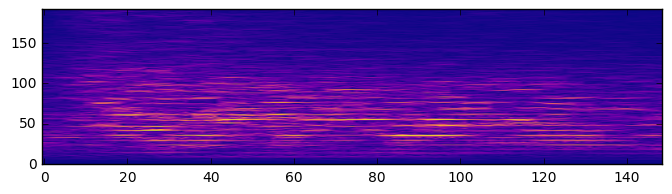

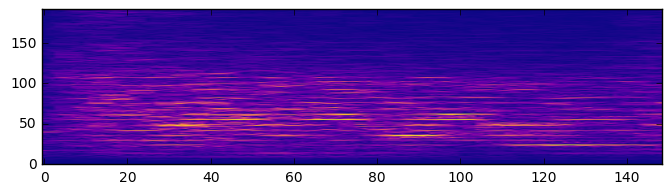

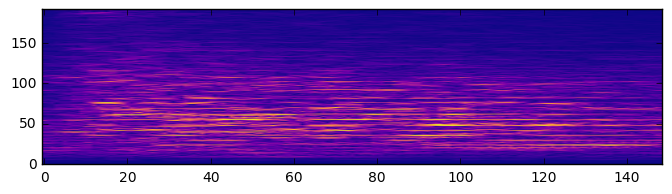

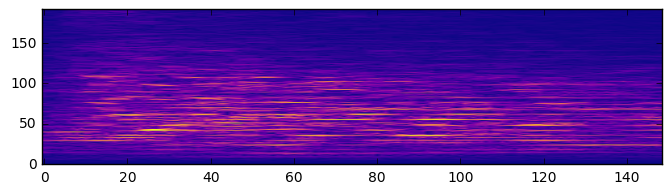

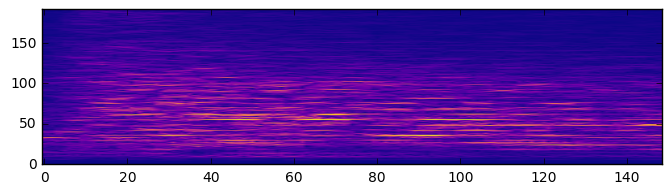

...

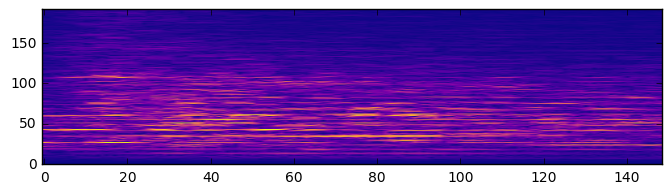

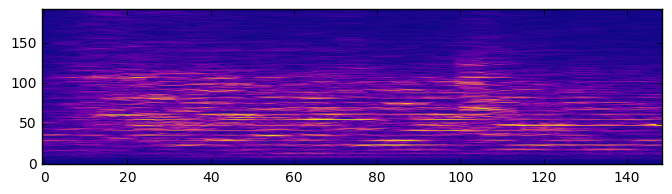

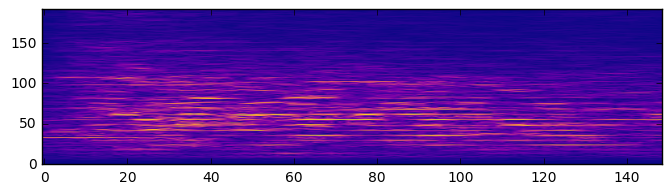

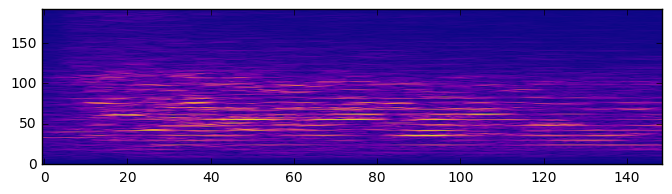

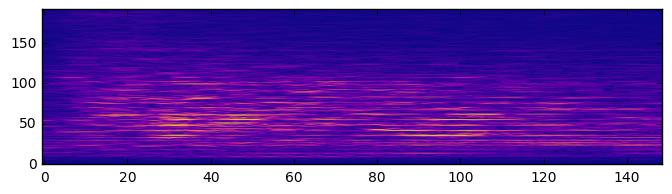

(192, 149)


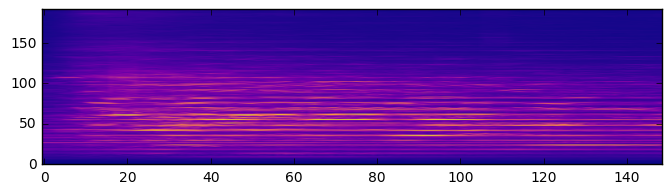

fast shapes:  (149, 192) (192, 336388)
done


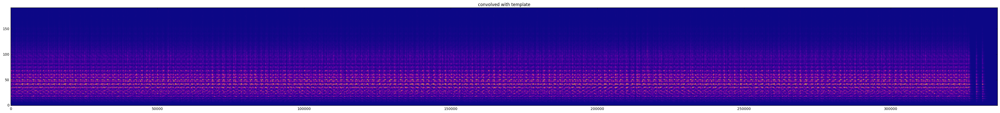

(336388,)
0.74252514921 1.28355048577
88 275


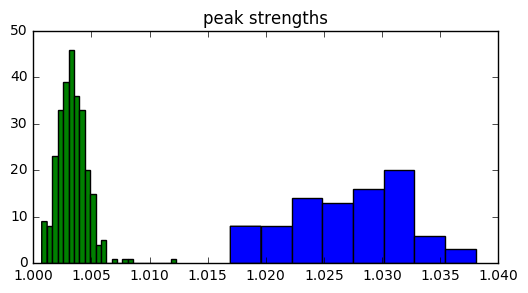

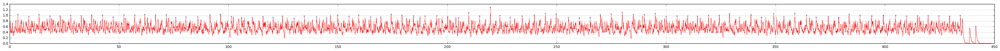

In [66]:
# Now, pile up the clips from the interesting offsets
# This shows that the selection algorithm is making some mistakes, and we shouldn't be using
# all the selected templates.

print zip(few_peaks, few_peaks[1:]-np.array(few_peaks[:-1]))

size = int(.2*sted_fps)
final = np.zeros((192,size))
for i in few_peaks:
    final += sted_Sxxr[:,i:i+size]
    plot_template(sted_Sxxr[:,i:i+size].T)
final /= len(few_peaks)
print final.shape

template2 = make_template(0, final, sted_fps, .2)

h2 = fast_match_sliding(template2, sted_Sxxr)

plot_peaks(sted_tl, h2, find_peaks(h2, sted_fps, 1.015, False), sted_fps)


In [ ]:
# Now we want to optimize the template, by determining each element's relative
# contribution to actual strikes, and false strikes (from opposite stroke or other bells)
# For each point in the template, we look at the average of the points in actual strikes,
# and the average of the corresponding points in false strikes.

'''
peaks = argrelmax(sted_left_hand, sted_fps/4, np.percentile(sted_left_hand, 95))
peak_intensity = []
for i in peaks:
    left = sted_left_hand[max(0,i-4)]
    right = sted_left_hand[min(len(sted_left_hand)-1, i+4)]
    size = 2*sted_left_hand[i] / (left+right)
    if size > 1.02: peak_intensity.append(i)

print peak_intensity

# Now, pile up the clips from the interesting offsets
size = int(.2*sted_fps)
final = np.zeros((192,size))
for i in peak_intensity:
    final += sted_Sxxl[:,i:i+size]
final /= len(peak_intensity)
print final.shape

template = make_template(0, final, sted_fps, .2)

sted_left_hand_avg = fast_match_sliding(template, sted_Sxxl)
plt.figure(figsize=(100,5), dpi=120)
axes = plt.gca()
plt.grid()
plt.plot(range(len(sted_left_hand_avg))/sted_fps, sted_left_hand_avg, 'r,')
plt.show()

print np.percentile(sted_left_hand_avg, 90), np.max(sted_left_hand_avg)
peaks = argrelmax(sted_left_hand_avg, sted_fps/4, np.percentile(sted_left_hand_avg, 90))
selected_peaks = []
good = []
bad = []
for i in peaks:
    left = sted_left_hand_avg[max(0,i-4)]
    right = sted_left_hand_avg[min(len(sted_left_hand_avg)-1, i+4)]
    size = 2*sted_left_hand_avg[i]/ (left+right)
    if size > 1.02:
        selected_peaks.append(i)
        good.append(size)
    else:
        bad.append(size)
selection_histo(good, bad)
print selected_peaks

plt.figure(figsize=(100,4), dpi=120)
plt.grid()
plt.plot(range(len(h))/sted_fps, sted_left_hand_avg, 'r,')
plt.plot(np.array(sted_tl)[selected_peaks]-.005, np.array(sted_left_hand_avg)[selected_peaks]+.005,
         'b.', fillstyle='none', markersize=5)
plt.show()
'''